Using a very simple cellular automata to track disturbed and undisturbed cells. 

# Initial state

The initial state is a 2D array of 0s and 1s. 0s represent undisturbed cells and 1s represent disturbed cells.

Cells are considered disturbed if they have a tree cover below median - 2 * std where those metrics are computed on the time series and per tree type : deciduous or evergreen. 

100%|██████████| 39/39 [00:00<00:00, 118.33it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


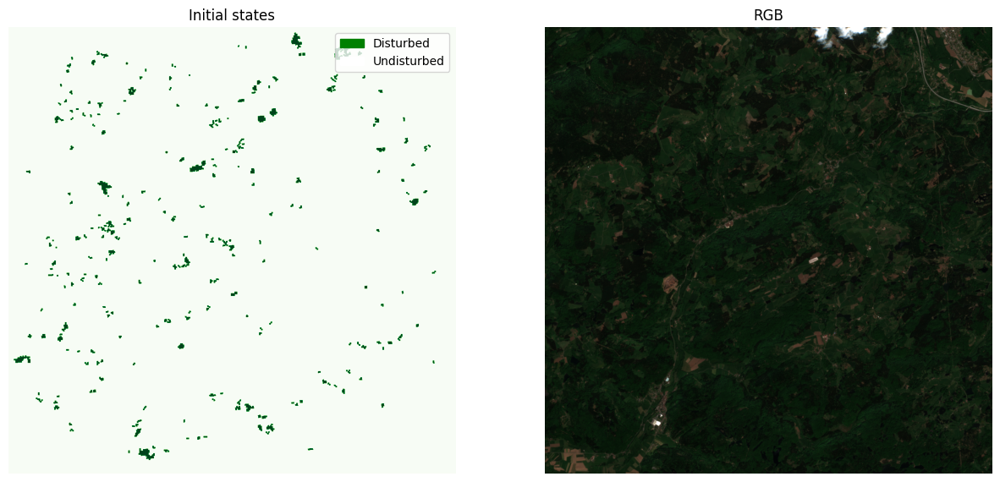

In [1]:
%matplotlib inline

import rasterio
import numpy as np
from utils import load_folder, normalize
from datetime import datetime

def compute_stats(tree_cover, mask, cover_type, disturbance):
    """Compute median and standard deviation of tree cover for a specified cover type."""
    filtered_data = tree_cover[:, (mask == cover_type) & (disturbance == 1)]
    median = np.nanmedian(filtered_data)
    std_dev = np.nanstd(filtered_data)
    min_val = np.nanmin(filtered_data)
    max_val = np.nanmax(filtered_data)
    return median, std_dev, min_val, max_val

import os 
folder_path = '/Users/arthurcalvi/Data/disturbances-ex/bbox_sampling/324_20141228_20231228_fr-BourgogneFrancheComte-HauteSaone_Lat47.88_Lon6.60'
tc = load_folder(os.path.join(folder_path, 'smoothed_treecover'))
rgb = load_folder(os.path.join(folder_path, 'rgb'))
disturbances = load_folder(os.path.join(folder_path, 'disturbances'))
sudden_disturbances = np.array([np.isin(disturbance, [1, 4, 5]) for disturbance in disturbances])
gradual_disturbances = np.array([np.isin(disturbance, [2, 3, 6]) for disturbance in disturbances])

gradual_disturbance_map = np.any(gradual_disturbances > 0, axis=0).astype(int)
sudden_disturbance_map = np.any(sudden_disturbances > 0, axis=0).astype(int)
# Compute stats for deciduous (assumed to be O) and evergreen (assumed to be 1)
disturbance_map = np.any(disturbances > 0, axis=0).astype(int)

 #TREE TYPE
tree_inf_folder= os.path.join(folder_path, 'tree_class')
#read one file contained
with rasterio.open(os.path.join(tree_inf_folder, os.listdir(tree_inf_folder)[0])) as src:
    tree_inf = src.read(1).astype('float32')

tree_inf[ tree_inf == -1] = np.nan

dates = [datetime.strptime(filename.split('_')[0], '%Y-%m-%d') for filename in os.listdir(os.path.join(folder_path, 'rgb'))]
dates.sort()

# initial_states = initialize_states(tc, tree_inf)
initial_states = (disturbances[0] > 0) * 2

import matplotlib.pyplot as plt
fig, ax = plt.subplots(1, 2, figsize=(15, 7))

ax[0].imshow(initial_states, cmap='Greens')
ax[0].set_title('Initial states')
ax[0].axis('off')
ax[1].imshow(normalize(rgb[0]).transpose(1, 2, 0))
ax[1].set_title('RGB')
ax[1].axis('off')

#add legend 1 = disturbed, 0 = undisturbed
import matplotlib.patches as mpatches
disturbed_patch = mpatches.Patch(color='green', label='Disturbed')
undisturbed_patch = mpatches.Patch(color='white', label='Undisturbed')
ax[0].legend(handles=[disturbed_patch, undisturbed_patch], loc='upper right')


In [2]:
# Compute stats for deciduous (assumed to be O) and evergreen (assumed to be 1)
gradual_deciduous_median, gradual_deciduous_std, gradual_deciduous_min, gradual_deciduous_max = compute_stats(tc, tree_inf, 0, gradual_disturbance_map)
gradual_evergreen_median, gradual_evergreen_std, gradual_evergreen_min, gradual_evergreen_max = compute_stats(tc, tree_inf, 1, gradual_disturbance_map)
sudden_deciduous_median, sudden_deciduous_std, sudden_deciduous_min, sudden_deciduous_max = compute_stats(tc, tree_inf, 0, sudden_disturbance_map)
sudden_evergreen_median, sudden_evergreen_std, sudden_evergreen_min, sudden_evergreen_max = compute_stats(tc, tree_inf, 1, sudden_disturbance_map)
print(f'Gradual deciduous: median={gradual_deciduous_median}, std={gradual_deciduous_std}, min={gradual_deciduous_min}, max={gradual_deciduous_max}')
print(f'Gradual evergreen: median={gradual_evergreen_median}, std={gradual_evergreen_std}, min={gradual_evergreen_min}, max={gradual_evergreen_max}')
print(f'Sudden deciduous: median={sudden_deciduous_median}, std={sudden_deciduous_std}, min={sudden_deciduous_min}, max={sudden_deciduous_max}')
print(f'Sudden evergreen: median={sudden_evergreen_median}, std={sudden_evergreen_std}, min={sudden_evergreen_min}, max={sudden_evergreen_max}')


Gradual deciduous: median=0.4996902048587799, std=0.29646366834640503, min=0.004671020433306694, max=1.0362411737442017
Gradual evergreen: median=0.6718534231185913, std=0.264581561088562, min=0.009070280939340591, max=1.031749963760376
Sudden deciduous: median=0.5031500458717346, std=0.3014063537120819, min=0.004671020433306694, max=1.0456104278564453
Sudden evergreen: median=0.6870565414428711, std=0.2745524048805237, min=0.006427960470318794, max=1.052871584892273


# Iteration

## Deseasonalization 

In practice : good idea but not all pixels have a seasonality. For instance, some pixels are disturbed at the beginning of the time series and remain disturbed.So removing a seasonality computed on the average pixels of deciduous or evergreen to those early disturbed pixels is just adding noide to the signal. 

Fitted parameters for Deciduous: a=0.04, phi=-0.84, b=0.33


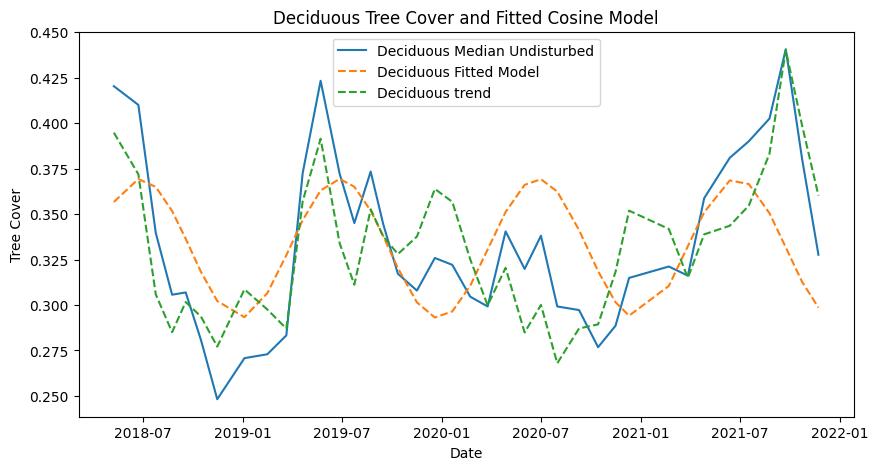

Fitted parameters for Evergreen: a=0.10, phi=-0.85, b=0.46


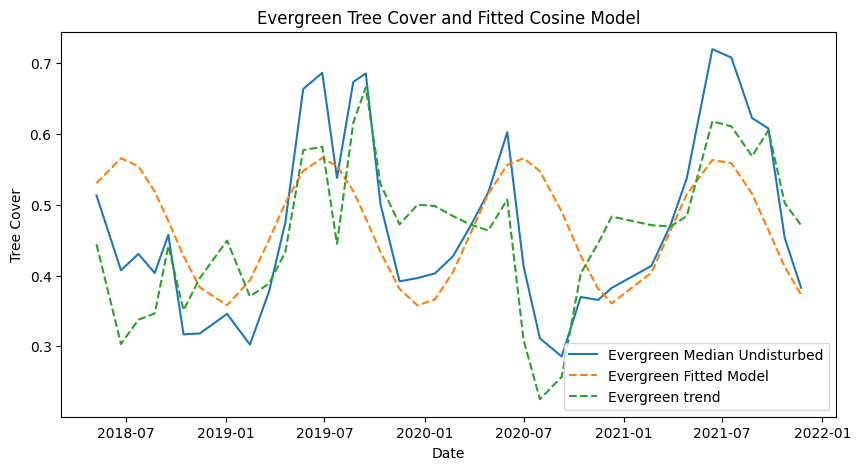

array([ 0.1044688 , -0.84989629,  0.        ])

In [4]:
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from datetime import datetime

# Convert datetime to numerical day of year for fitting
day_of_year = np.array([(date - dates[0]).days for date in dates])

# Define the cosine function to fit
def cosine_function(t, a, phi1, b):
    return a * np.cos(2 * np.pi * t / 365.25 + phi1) + b 

def fit_and_plot(time_series, day_of_year, label, plot=True):
    # Curve fitting
    params, params_covariance = curve_fit(cosine_function, day_of_year, time_series,
                                          p0=[1, 0, np.mean(time_series)])

    # Print the parameters
    print(f"Fitted parameters for {label}: a={params[0]:.2f}, phi={params[1]:.2f}, b={params[2]:.2f}")

    # Generate data from the fitted model
    fitted_data = cosine_function(day_of_year, *params)

    params[-1] = 0
    seasonal_data = cosine_function(day_of_year, *params)

    # Plot
    if plot:
        plt.figure(figsize=(10, 5))
        plt.plot(dates, time_series, label=f'{label} Median Undisturbed')
        plt.plot(dates, fitted_data, label=f'{label} Fitted Model', linestyle='--')
        plt.plot(dates, time_series - seasonal_data, label=f'{label} trend', linestyle='--')
        plt.title(f'{label} Tree Cover and Fitted Cosine Model')
        plt.xlabel('Date')
        plt.ylabel('Tree Cover')
        plt.legend()
        plt.show()

    return params

# Load your tree cover data (tc), tree information map (tree_inf), and disturbance map
# Here we use your provided code snippets to get the median behavior
filtered_data_deciduous = tc[:, (tree_inf == 0) & (disturbance_map == 0)]
median_deciduous = np.nanmedian(filtered_data_deciduous[:,:1], axis=(1))

filtered_data_evergreen = tc[:, (tree_inf == 1) & (disturbance_map == 0)]
median_evergreen = np.nanmedian(filtered_data_evergreen[:,:1], axis=(1))

# Fit and plot for both types
fit_and_plot(median_deciduous, day_of_year, 'Deciduous')
fit_and_plot(median_evergreen, day_of_year, 'Evergreen')

In [5]:
import numpy as np

def remove_seasonality(tree_cover_timeseries, tree_type_map, params_deciduous, params_evergreen, dates):
    """
    Remove seasonality from the tree cover time series using vectorized operations.
    
    Parameters:
    - tree_cover_timeseries: 3D numpy array [time, height, width], tree cover data
    - tree_type_map: 2D numpy array [height, width], indicates the type of tree (0 for deciduous, 1 for evergreen)
    - params_deciduous: tuple/list, parameters (a, phi, b) for the deciduous trees' fitted model
    - params_evergreen: tuple/list, parameters (a, phi, b) for the evergreen trees' fitted model
    - dates: list of datetime objects, corresponding to each time step in the tree_cover_timeseries

    Returns:
    - tree_cover_deseasonalized: 3D numpy array [time, height, width], tree cover data with seasonality removed
    """
    # Convert datetime to numerical day of year for computation
    day_of_year = np.array([(date - dates[0]).days for date in dates])
    T = day_of_year.reshape(-1, 1, 1)  # Reshape for broadcasting

    # Calculate the cosine function for both tree types
    seasonality_deciduous = cosine_function(T, *params_deciduous)
    seasonality_evergreen = cosine_function(T, *params_evergreen)

    # Use broadcasting to create a full 3D seasonality map for each tree type
    mask_deciduous = (tree_type_map == 0)
    mask_evergreen = (tree_type_map == 1)

    # Combine the seasonality maps based on the tree type map
    seasonality_map_deciduous = np.where(mask_deciduous[np.newaxis, :], seasonality_deciduous, 0)
    seasonality_map_evergreen = np.where(mask_evergreen[np.newaxis, :], seasonality_evergreen, 0)


    # Subtract the seasonality from the original tree cover data
    tree_cover_deseasonalized = tree_cover_timeseries - seasonality_map_deciduous - seasonality_map_evergreen

    return tree_cover_deseasonalized.clip(0, 1)

filtered_data_deciduous = tc[:, (tree_inf == 0) & (disturbance_map == 0)]
median_deciduous = np.nanmedian(filtered_data_deciduous, axis=(1))

filtered_data_evergreen = tc[:, (tree_inf == 1) & (disturbance_map == 0)]
median_evergreen = np.nanmedian(filtered_data_evergreen, axis=(1))

# Fit and plot for both types
params_deciduous = fit_and_plot(median_deciduous, day_of_year, 'Deciduous', plot=False)
params_evergreen = fit_and_plot(median_evergreen, day_of_year, 'Evergreen', plot=False)

tc_deseasonalized = remove_seasonality(tc, tree_inf, params_deciduous, params_evergreen, dates)

#WRITE tc_deseasonalized 
import rasterio 
from tqdm import tqdm

os.makedirs(os.path.join(folder_path, 'deseasonalized_treecover'), exist_ok=True)
src = rasterio.open(os.path.join(folder_path, 'smoothed_treecover', os.listdir(os.path.join(folder_path, 'smoothed_treecover'))[0]))
for i, date in tqdm(enumerate(dates)):
    with rasterio.open(os.path.join(folder_path, 'deseasonalized_treecover', f'{date.strftime("%Y-%m-%d")}_deseasonalized.tif'), 'w', **src.profile) as dst:
        dst.write(tc_deseasonalized[i].astype('float32'), 1)

Fitted parameters for Deciduous: a=0.30, phi=-1.37, b=0.59
Fitted parameters for Evergreen: a=0.18, phi=-1.15, b=0.73


39it [00:01, 27.90it/s]


## Identification of undisturbed cells

We compute the slope of the time series for each cell. If the slope is around 0, the cell is considered undisturbed.
We could use this map to constrain the CA to only update the disturbed cells.

- fitting of AX + B to the time series.
- undisturbed pixel is defined as |A| < 0.1
- percentage of undisturbed pixels per tree type is computed. 

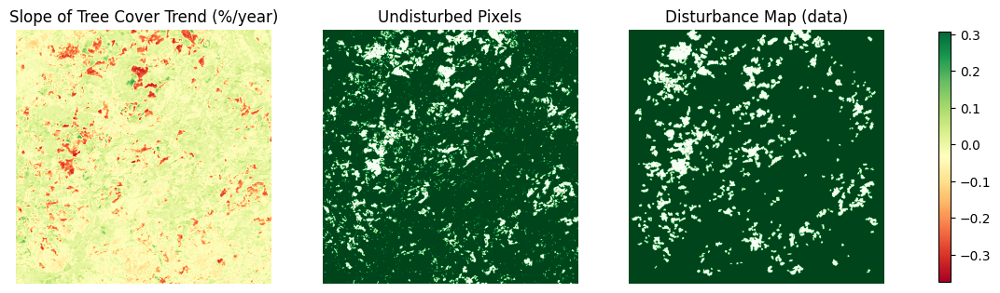

In [2]:
def datetime_to_ordinal(dates):
    """Convert datetime objects to days since the first date in the list."""
    base_date = dates[0]
    return np.array([(date - base_date).days for date in dates]) 


def calculate_slope_with_dates(tree_cover_timeseries, dates, n, K):
    """
    Calculate the slope of linear regression over tree cover data using actual dates for each time step.

    Parameters:
    - tree_cover_timeseries: 3D numpy array [time, height, width]
    - dates: list of datetime objects corresponding to each time step
    - n: int, central time index
    - K: int, window size around the central index

    Returns:
    - slope_map: 2D numpy array [height, width] representing the slope of the tree cover trend
    """
    # Define the time window
    start_index = max(n - K, 0)
    end_index = min(n + K + 1, tree_cover_timeseries.shape[0])

    # Convert dates to ordinal days
    date_nums = datetime_to_ordinal(dates[start_index:end_index])

    # Create the time indices matrix
    t = date_nums.reshape(-1, 1)  # Column vector
    X = np.hstack([t, np.ones((t.shape[0], 1))])  # Add a column of ones for the intercept

    # Reshape the data so each pixel's time series is a column
    Y = tree_cover_timeseries[start_index:end_index].reshape(t.shape[0], -1)

    # Perform matrix multiplication for the linear regression coefficients
    XT_X = X.T @ X
    XT_X_inv = np.linalg.inv(XT_X)
    XT_Y = X.T @ Y
    beta = XT_X_inv @ XT_Y

    # Extract the slope (first row of beta)
    slopes = beta[0, :].reshape(tree_cover_timeseries.shape[1], tree_cover_timeseries.shape[2])

    return slopes # %/day


#compute the slope for the entire time series 
slope_map = calculate_slope_with_dates(tc, dates, len(tc)/2, len(tc))

fig, ax = plt.subplots(1, 3, figsize=(15, 7))
im = ax[0].imshow(slope_map * 365, cmap='RdYlGn')
ax[0].set_title('Slope of Tree Cover Trend (%/year)')
plt.colorbar(im, ax=ax, shrink=0.5)
undisturbed_pixel = abs(slope_map * 365) < 0.1
ax[1].imshow(undisturbed_pixel, cmap='Greens')
ax[1].set_title('Undisturbed Pixels')
ax[2].imshow(disturbance_map, cmap='Greens_r')
ax[2].set_title('Disturbance Map (data)')
for a in ax:
    a.set_axis_off()

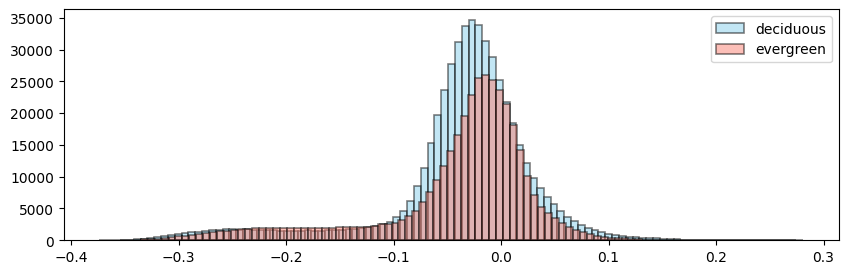

In [3]:
fig, ax = plt.subplots(1, 1, figsize=(10, 3))

_ = ax.hist(slope_map[tree_inf == 0].reshape(-1) * 365, bins=100, color='skyblue', edgecolor='black', linewidth=1.2, label='deciduous', alpha=0.5)
_ = ax.hist(slope_map[tree_inf == 1].reshape(-1) * 365, bins=100, color='salmon', edgecolor='black', linewidth=1.2, label='evergreen', alpha=0.5)
ax.legend()

In [4]:
#count percentage of undisturbed evergreen pixels
total_evergreen = np.sum(tree_inf == 1)
undisturbed_evergreen = np.sum(undisturbed_pixel & (tree_inf == 1)) / total_evergreen

print(f'Percentage of undisturbed evergreen pixels: {undisturbed_evergreen * 100:.2f}%')

#count percentage of undisturbed deciduous pixels
total_deciduous = np.sum(tree_inf == 0)
undisturbed_deciduous = np.sum(undisturbed_pixel & (tree_inf == 0)) / total_deciduous
print(f'Percentage of undisturbed deciduous pixels: {undisturbed_deciduous * 100:.2f}%')

Percentage of undisturbed evergreen pixels: 84.20%
Percentage of undisturbed deciduous pixels: 88.05%


## Computation of Short and Long trends

In [5]:
from datetime import datetime

def calculate_tree_cover_change(tree_cover_previous, tree_cover_current, date_previous, date_current):
    """
    Calculate the change in tree cover between two time steps, normalized by the number of days between measurements.

    Parameters:
    - tree_cover_previous: float, tree cover at the previous time step
    - tree_cover_current: float, tree cover at the current time step
    - date_previous: datetime, date of the previous measurement
    - date_current: datetime, date of the current measurement

    Returns:
    - change_per_day: float, the daily change rate in tree cover
    """
    # Calculate the raw change in tree cover
    change = tree_cover_current - tree_cover_previous
    
    # Calculate the number of days between the two measurements
    num_days = (date_current - date_previous).days
    if num_days == 0:
        raise ValueError("The two dates should not be the same to avoid division by zero.")

    # Normalize the change by the number of days to get a daily change rate
    change_per_day = change / num_days

    return change_per_day


# Example usage:
n = 20 # Central index, ensure there's enough data around it
K = 5  # Window size # Example data
slope_map = calculate_slope_with_dates(tc, dates, n, K)  

change_rate = calculate_tree_cover_change(tc[n - 1], tc[n], dates[n - 1], dates[n])


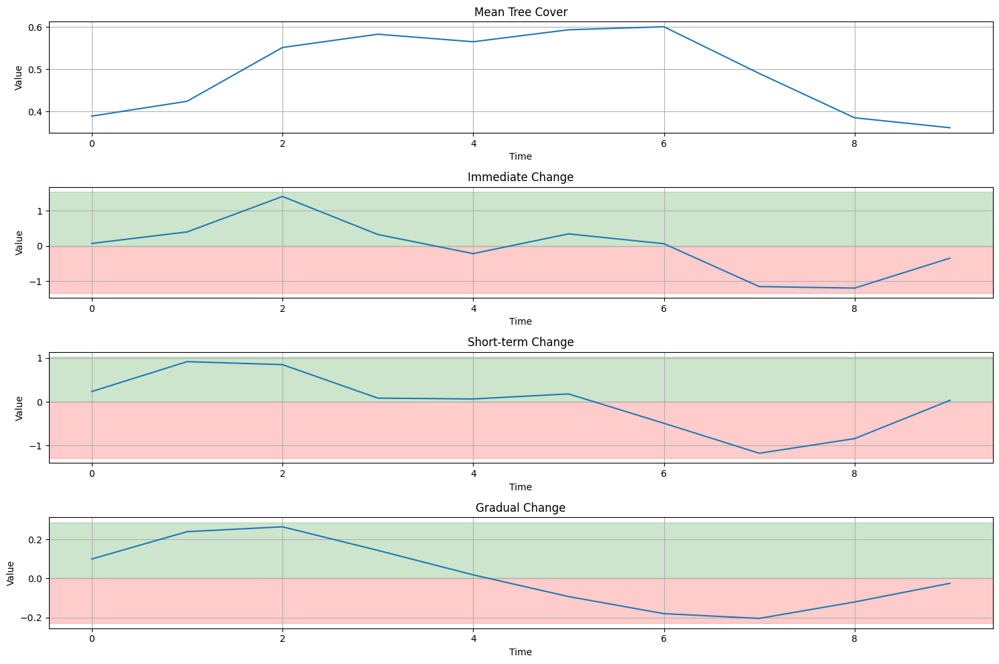

In [39]:
#display the changes for random selection of pixels 
import matplotlib.pyplot as plt
a,b,c,d = 20, 30, 20, 30
fig, axes = plt.subplots(4, 1, figsize=(15, 10))
axes[0].plot(tc[a:b, c:d].mean(axis=(1,2)))
axes[0].set_title('Mean Tree Cover')
axes[1].plot(immediate_changes[a:b, c:d].mean(axis=(1,2)))
axes[1].set_title('Immediate Change')
axes[2].plot(short_changes[a:b, c:d].mean(axis=(1,2)))
axes[2].set_title('Short-term Change')
axes[3].plot(gradual_changes[a:b, c:d].mean(axis=(1,2)))
axes[3].set_title('Gradual Change')

for ax in axes:
    ax.set_xlabel('Time')
    ax.set_ylabel('Value')
    ax.grid(True)

for ax in axes[1:]:
    #add green rectangle on the y = 0,1 zone
    ax.axhspan(0, ax.get_ylim()[1], color='green', alpha=0.2)
    ax.axhspan(ax.get_ylim()[0], 0, color='red', alpha=0.2)

plt.tight_layout()




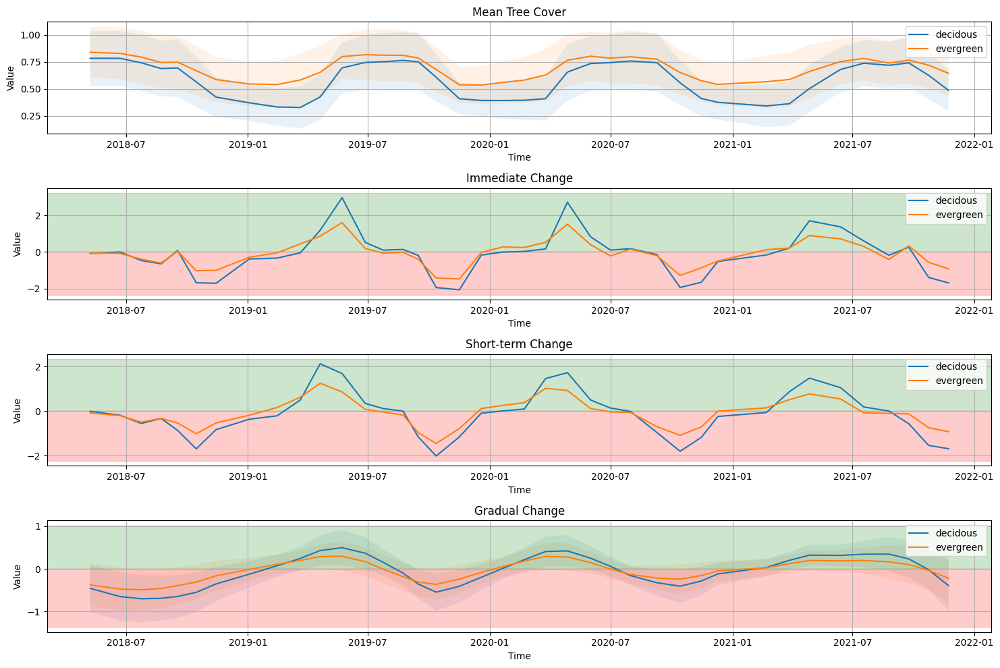

In [9]:



fig, axes = plt.subplots(4, 1, figsize=(15, 10))
axes[0].plot(dates, tc_deciduous_undisturbed.mean(axis=1), label='decidous')
axes[0].fill_between(dates, tc_deciduous_undisturbed.mean(axis=1) - tc_deciduous_undisturbed.std(axis=1), tc_deciduous_undisturbed.mean(axis=1) + tc_deciduous_undisturbed.std(axis=1), alpha=0.1)
axes[0].plot(dates, tc[:, (tree_inf == 1) & (undisturbed_pixel == 1)].mean(axis=1), label='evergreen')
axes[0].fill_between(dates, tc_evergreen_undisturbed.mean(axis=1) - tc_evergreen_undisturbed.std(axis=1), tc_evergreen_undisturbed.mean(axis=1) + tc_evergreen_undisturbed.std(axis=1), alpha=0.1)
axes[0].set_title('Mean Tree Cover')
axes[1].plot(dates, immediate_changes[:, (tree_inf == 0) & (undisturbed_pixel == 1)].mean(axis=1), label='decidous')
axes[1].plot(dates, immediate_changes[:, (tree_inf == 1) & (undisturbed_pixel == 1)].mean(axis=1), label='evergreen')
axes[1].set_title('Immediate Change')
axes[2].plot(dates, short_changes[:, (tree_inf == 0) & (undisturbed_pixel == 1)].mean(axis=1), label='decidous')
axes[2].plot(dates, short_changes[:, (tree_inf == 1) & (undisturbed_pixel == 1)].mean(axis=1), label='evergreen')
axes[2].set_title('Short-term Change')
axes[3].plot(dates, gradual_changes[:, (tree_inf == 0) & (undisturbed_pixel == 1)].mean(axis=1), label='decidous')
axes[3].fill_between(dates, gradual_changes_deciduous_undisturbed_lb, gradual_changes_deciduous_undisturbed_ub, alpha=0.1)
axes[3].plot(dates, gradual_changes[:, (tree_inf == 1) & (undisturbed_pixel == 1)].mean(axis=1), label='evergreen')
axes[3].fill_between(dates, gradual_changes_evergreen_undisturbed_lb, gradual_changes_evergreen_undisturbed_ub, alpha=0.1)
axes[3].set_title('Gradual Change')

for ax in axes:
    ax.set_xlabel('Time')
    ax.set_ylabel('Value')
    ax.grid(True)
    ax.legend()

for ax in axes[1:]:
    #add green rectangle on the y = 0,1 zone
    ax.axhspan(0, ax.get_ylim()[1], color='green', alpha=0.2)
    ax.axhspan(ax.get_ylim()[0], 0, color='red', alpha=0.2)

plt.tight_layout()


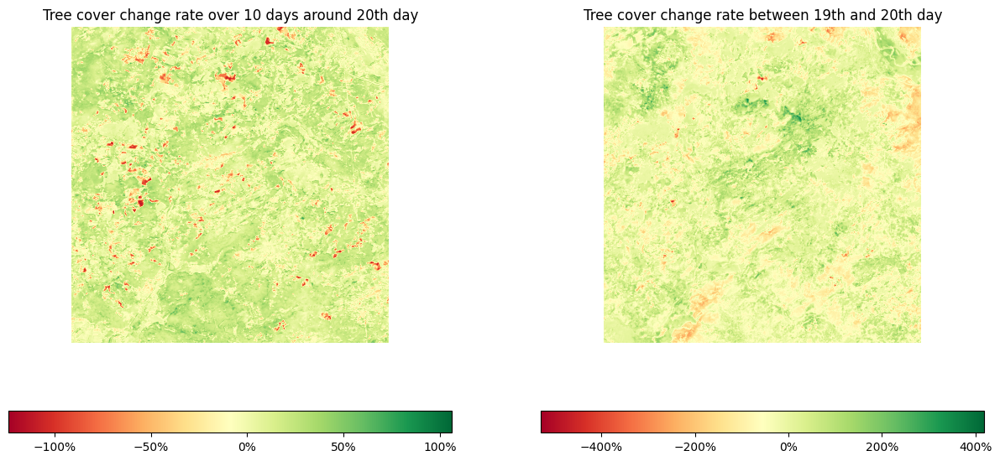

In [6]:
%matplotlib inline

fig, ax = plt.subplots(1, 2, figsize=(15, 7))
im0 = ax[0].imshow(slope_map * 365, cmap='RdYlGn')
ax[0].set_title(f'Tree cover change rate over {2*K} days around {n}th day')
ax[0].axis('off')
im1 = ax[1].imshow(change_rate * 365, cmap='RdYlGn')
ax[1].set_title(f'Tree cover change rate between {n-1}th and {n}th day')
ax[1].axis('off')
#AD COLORBARS
#add colorbar label : %/year
#firmat as percentage
import matplotlib.colors as mcolors
from matplotlib import ticker
formatter = ticker.PercentFormatter(xmax=1, decimals=0)
norm = mcolors.Normalize(vmin=-1, vmax=1)
fig.colorbar(mappable=im0, ax=ax[0], orientation='horizontal', format=formatter)
fig.colorbar(mappable=im1, ax=ax[1], orientation='horizontal', format=formatter)




## Detections of changes

In [6]:
#TREE PROB
from tqdm import tqdm
from skimage.filters import rank
from skimage.morphology import disk
tree_prob_folder = os.path.join(folder_path, 'tree_prob')
#read one file contained
with rasterio.open(os.path.join(tree_prob_folder, os.listdir(tree_prob_folder)[0])) as src:
    forest_segmentation = src.read(1)

nm = 3
#add erosion of 3 pixels
from skimage.morphology import erosion
forest_segmentation = erosion(forest_segmentation, disk(3))
mean_tree_prob_erosion = (rank.mean(forest_segmentation, disk(nm)) / 255).astype('float32')

/Users/arthurcalvi/Repo/ChangeDetectionDisturbances/.venv/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3577: UserWarning: Possible precision loss converting image of type float32 to uint8 as required by rank filters. Convert manually using skimage.util.img_as_ubyte to silence this warning.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [7]:
#compute the slope for each pixel
from tqdm import tqdm

immediate_changes = []
short_changes = []
gradual_changes = []
for i in tqdm(range(len(tc))):
    immediate_change = calculate_tree_cover_change(tc[i - 1], tc[i], dates[i - 1], dates[i]) * 365 
    short_change = calculate_slope_with_dates(tc, dates, i, 1) * 365
    gradual_change = calculate_slope_with_dates(tc, dates, i, K) * 365
    immediate_changes.append(immediate_change)
    short_changes.append(short_change)
    gradual_changes.append(gradual_change)

gradual_changes = np.array(gradual_changes)
short_changes = np.array(short_changes)
immediate_changes = np.array(immediate_changes)

#pixels sains : 
k_deciduous = 1 + (1 - undisturbed_deciduous)
k_evergreen = 1 + (1 - undisturbed_evergreen)
deciduous_undisturbed = (tree_inf == 0) & (undisturbed_pixel == 1)
evergreen_undisturbed = (tree_inf == 1) & (undisturbed_pixel == 1)
tc_deciduous_undisturbed = tc[:, deciduous_undisturbed]
tc_evergreen_undisturbed = tc[:, evergreen_undisturbed]

100%|██████████| 39/39 [00:02<00:00, 15.89it/s]


### Gradual changes

Pour détecter les perturbations graduelles dans le couvert forestier, j'applique une méthode structurée en plusieurs étapes clés. Après avoir établi les seuils de perturbation basés sur les calculs de la pente dans les séries temporelles, j'entre dans la phase d'analyse dynamique des changements au fil du temps.


In [8]:


short_changes_deciduous_undisturbed = short_changes[:, deciduous_undisturbed]
short_changes_evergreen_undisturbed = short_changes[:, evergreen_undisturbed]
gradual_changes_deciduous_undisturbed = gradual_changes[:, deciduous_undisturbed]
gradual_changes_evergreen_undisturbed = gradual_changes[:, evergreen_undisturbed]
gradual_changes_deciduous_undisturbed_ub = gradual_changes_deciduous_undisturbed.mean(axis=1) + 1.5 * k_deciduous * gradual_changes_deciduous_undisturbed.std(axis=1)
gradual_changes_deciduous_undisturbed_lb = gradual_changes_deciduous_undisturbed.mean(axis=1) - 1.5 * k_deciduous * gradual_changes_deciduous_undisturbed.std(axis=1)
gradual_changes_evergreen_undisturbed_ub = gradual_changes_evergreen_undisturbed.mean(axis=1) + 1.5 * k_evergreen * gradual_changes_evergreen_undisturbed.std(axis=1)
gradual_changes_evergreen_undisturbed_lb = gradual_changes_evergreen_undisturbed.mean(axis=1) - 1.5 * k_evergreen * gradual_changes_evergreen_undisturbed.std(axis=1)


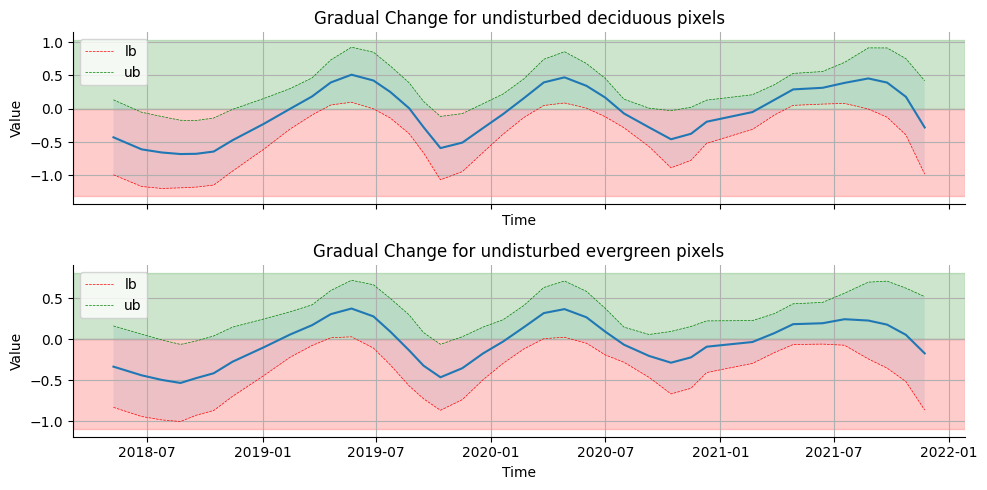

In [10]:
%matplotlib inline
#figure for showing the 'normal' and bounds for gradual changes
fig, ax = plt.subplots(2, 1, figsize=(10, 5), sharex=True)

ax[0].plot(dates, gradual_changes[:, (tree_inf == 0) & (undisturbed_pixel == 1)].mean(axis=1))
ax[0].set_title('Gradual Change for undisturbed deciduous pixels')
ax[0].fill_between(dates, gradual_changes_deciduous_undisturbed_lb, gradual_changes_deciduous_undisturbed_ub, alpha=0.1)
ax[0].plot(dates, gradual_changes_deciduous_undisturbed_lb, 'r--', label='lb', lw=0.5)
ax[0].plot(dates, gradual_changes_deciduous_undisturbed_ub, 'g--', label='ub', lw=0.5)

ax[1].plot(dates, gradual_changes[:, (tree_inf == 1) & (undisturbed_pixel == 1)].mean(axis=1))
ax[1].set_title('Gradual Change for undisturbed evergreen pixels')
ax[1].fill_between(dates, gradual_changes_evergreen_undisturbed_lb, gradual_changes_evergreen_undisturbed_ub, alpha=0.1)
ax[1].plot(dates, gradual_changes_evergreen_undisturbed_lb, 'r--', label='lb', lw=0.5)
ax[1].plot(dates, gradual_changes_evergreen_undisturbed_ub, 'g--', label='ub', lw=0.5)

for a in ax:
    a.set_xlabel('Time')
    a.set_ylabel('Value')
    a.grid(True)
    a.legend()
    a.spines['top'].set_visible(False)
    a.spines['right'].set_visible(False)

#add green rectangle on the y = 0,1 zone
ax[0].axhspan(0, ax[0].get_ylim()[1], color='green', alpha=0.2)
ax[0].axhspan(ax[0].get_ylim()[0], 0, color='red', alpha=0.2)
ax[1].axhspan(0, ax[1].get_ylim()[1], color='green', alpha=0.2)
ax[1].axhspan(ax[1].get_ylim()[0], 0, color='red', alpha=0.2)

plt.tight_layout()

Let's see if there is a spatial difference and if we need to take it into account by doing a more local approach

100%|██████████| 39/39 [00:02<00:00, 17.13it/s]


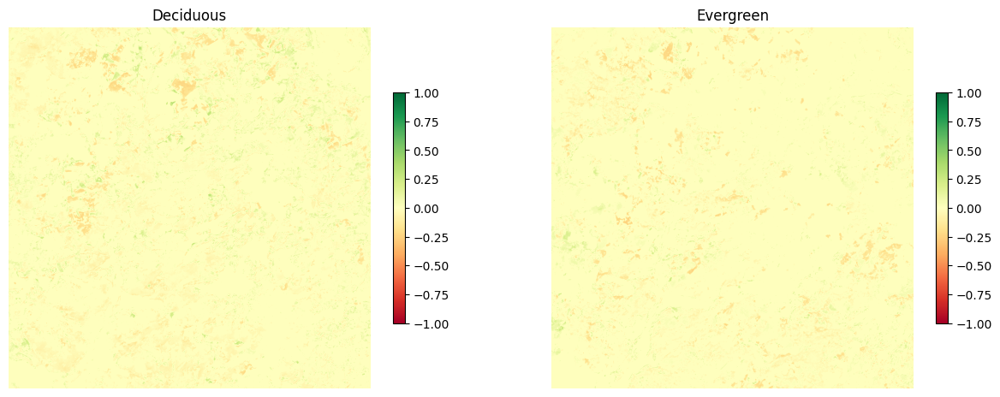

In [9]:
#TREE PROB
from tqdm import tqdm
from skimage.filters import rank
from skimage.morphology import disk
tree_prob_folder = os.path.join(folder_path, 'tree_prob')
#read one file contained
with rasterio.open(os.path.join(tree_prob_folder, os.listdir(tree_prob_folder)[0])) as src:
    forest_segmentation = src.read(1)

nm = 5
mean_tree_prob = (rank.mean(forest_segmentation, disk(nm)) / 255).astype('float32')

# Compute stats for deciduous (assumed to be O) and evergreen (assumed to be 1)
disturbance_map = np.any(disturbances > 0, axis=0).astype(int)
kernel = np.array([[1, 1, 1],
                       [1, 1, 1],
                       [1, 1, 1]])

initial_state = (disturbances[0] > 0) * 1
states = [initial_state]
slopes_corrected = []
K = 5 
for i in tqdm(range(len(tc))):
    # Apply convolution to count neighbors based on current state
    undisturbed_slope_corrected = np.zeros_like(initial_state, dtype=float)
    undisturbed_slope_corrected[ tree_inf == 0 ] = gradual_changes_deciduous_undisturbed[i].mean()
    undisturbed_slope_corrected[ tree_inf == 1 ] = gradual_changes_evergreen_undisturbed[i].mean()
    slope = calculate_slope_with_dates(tc, dates, i, K) * 365
    slope_corrected = slope - undisturbed_slope_corrected
    slopes_corrected.append(slope_corrected)

slope_corrected = np.array(slopes_corrected).mean(axis=0)
slope_corrected_evergreen = slope_corrected.copy()
slope_corrected_evergreen[ tree_inf != 1 ] = 0
slope_corrected_deciduous = slope_corrected.copy()
slope_corrected_deciduous[ tree_inf != 0 ] = 0
fig, ax = plt.subplots(1, 2, figsize=(15, 7))
im0 = ax[0].imshow(slope_corrected_deciduous, cmap='RdYlGn', vmin=-1, vmax=1)
plt.colorbar(im0, ax=ax[0], shrink=0.5)
ax[0].set_title('Deciduous')
im1 = ax[1].imshow(slope_corrected_evergreen, cmap='RdYlGn', vmin=-1, vmax=1)
plt.colorbar(im1, ax=ax[1], shrink=0.5)
ax[1].set_title('Evergreen')

for a in ax:
    a.set_axis_off()

In [10]:
#TEST Chaine de markov
import numpy as np
from scipy.signal import convolve2d

# Définir les états
states_description = {
    0: 'non perturbé',
    1: 'perturbation légère',
    2: 'perturbation modérée',
    3: 'perturbation sévère'
}

# Initialisation des états
initial_state = np.zeros_like(tc[0])  # Exemple simplifié
K = 5
# Matrice de transition des états
# Cette matrice doit être remplie en fonction de votre connaissance du sujet ou des données
# Exemple de matrice de transition simplifiée
norm = np.ones_like(initial_state, dtype=float)
norm[tree_inf == 0 ] = gradual_changes_deciduous_undisturbed.std()*3
norm[tree_inf == 1 ] = gradual_changes_evergreen_undisturbed.std()*3

states = [initial_state]

# Application de la chaîne de Markov
print('Application de la chaîne de Markov')
for i in tqdm(range(1, len(tc))):
    current_state = states[-1]
    next_state = np.zeros_like(current_state)
    
    # Calculez les seuils basé sur les informations précédentes
    undisturbed_slope_lb = np.zeros_like(current_state, dtype=float)
    undisturbed_slope_lb[tree_inf == 0] = gradual_changes_deciduous_undisturbed_lb[i]
    undisturbed_slope_lb[tree_inf == 1] = gradual_changes_evergreen_undisturbed_lb[i]
    
    # Calcul de la pente et détermination de l'état suivant
    slope = calculate_slope_with_dates(tc, dates, i, K) * 365
    # Détermination de l'état suivant basé sur la différence avec la lower bound
    for state in range(4):
        slope_diff = undisturbed_slope_lb - slope  # Différence entre la lower bound et la pente actuelle
        
        # Définir les transitions en fonction de la différence
        disturbed = slope_diff > 0  # Si la différence est positive, cela signifie que la pente est inférieure à la lower bound
        if disturbed.any():
            # Plus la différence est grande, plus la perturbation est considérée comme sévère
            transition_prob = np.clip(slope_diff *  mean_tree_prob_erosion  / norm, 0, 1)  # Normalisation de la probabilité
            severity_level = np.digitize(transition_prob, bins=[0.25, 0.5, 0.75])  # Convertit la probabilité en niveaux de sévérité
            
            for level in range(1, 4):  # Les états 1 à 3 représentent les différents niveaux de perturbation
                next_state[(severity_level == level) & disturbed] = level
                
        # État non perturbé
        next_state[~disturbed] = 0 

    states.append(next_state)

# Utiliser convolve2d pour calculer les états en tenant compte des voisins
kernel = np.array([[1, 1, 1],
                   [1, 0, 1],
                   [1, 1, 1]])

print('Application de la convolution')
for i in tqdm(range(1, len(states))):
    neighbor_effect = convolve2d(states[i-1], kernel, mode='same', boundary='wrap') 
    states[i] = np.where(neighbor_effect > 4, np.minimum(states[i] + 1, 3), states[i])

gradual_changes = states

Application de la chaîne de Markov


100%|██████████| 38/38 [00:05<00:00,  6.79it/s]


Application de la convolution


100%|██████████| 38/38 [00:01<00:00, 24.96it/s]


In [83]:
%matplotlib notebook

rgb = load_folder(os.path.join(folder_path, 'rgb'))

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


# Create a ListedColormap with specific colors or use 'viridis'
cmap = plt.get_cmap('viridis', 4)  # Assuming four states

def animate_states(states, rgb):
    """
    Animate each state in the states list along with corresponding RGB images.

    Args:
    - states: List of numpy arrays, where each array represents the state grid at a time step.
    - rgb: List of RGB images corresponding to each state for visualization.
    """
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))

    # Initialize the plots
    state_img = ax[0].imshow(states[0], cmap=cmap, vmin=0, vmax=3, interpolation='none')
    rgb_img = ax[1].imshow(normalize(rgb[0]).transpose(1, 2, 0))

    ax[0].set_axis_off()
    ax[1].set_axis_off()
    ax[0].set_title('State Grid')
    ax[1].set_title('RGB Image')

    def update(frame):
        """Update function for animation."""
        state_img.set_data(states[frame])
        rgb_img.set_data(normalize(rgb[frame]).transpose(1, 2, 0))  # Assuming rgb is properly scaled

        ax[0].set_title(f'Time Step: {frame}')
        return state_img, rgb_img,

    # Create animation
    ani = FuncAnimation(fig, update, frames=len(states), interval=100, blit=True)

    # Close the figure to prevent it from displaying statically (uncomment if necessary in your environment)
    # plt.close(fig)
    return HTML(ani.to_jshtml()) 

# Example usage:
# Assuming 'states' and 'rgb' are lists of numpy arrays
# This function would be called in your notebook like so:
animation = animate_states(states, rgb)
display(animation)


  8%|▊         | 3/39 [00:00<00:01, 27.15it/s]

100%|██████████| 39/39 [00:00<00:00, 39.21it/s]


<IPython.core.display.Javascript object>

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

In [55]:
#write each state to a new folder called 'states'
import os
import rasterio
from tqdm import tqdm

folder_name = 'gradual_change'
os.makedirs(os.path.join(folder_path, folder_name), exist_ok=True)
src = rasterio.open(os.path.join(folder_path, 'rgb', os.listdir(os.path.join(folder_path, 'rgb'))[0]))
dates = [datetime.strptime(filename.split('_')[0], '%Y-%m-%d') for filename in os.listdir(os.path.join(folder_path, 'rgb'))]
dates.sort()
profile = src.profile
profile.update(count=1, dtype='uint8')
for i, state in tqdm(enumerate(states)):
    with rasterio.open(os.path.join(folder_path, folder_name, f'{dates[i].strftime("%Y-%m-%d")}_state.tif'), 'w', **src.profile) as dst:
        dst.write(state.astype('uint8'), 1)

39it [00:01, 31.13it/s]


### Recovery

In [11]:
#TEST Chaine de markov
import numpy as np
from scipy.signal import convolve2d

# Définir les états
states_description = {
    0: 'non perturbé',
    1: 'recovery légère',
    2: 'recovery modérée',
    3: 'recovery forte'
}

# Initialisation des états
initial_state = np.zeros_like(tc[0])  # Exemple simplifié

# Matrice de transition des états
# Cette matrice doit être remplie en fonction de votre connaissance du sujet ou des données
# Exemple de matrice de transition simplifiée
norm = np.ones_like(initial_state, dtype=float)
norm[tree_inf == 0 ] = gradual_changes_deciduous_undisturbed.std()*3
norm[tree_inf == 1 ] = gradual_changes_evergreen_undisturbed.std()*3

states = [initial_state]
K = 5 
# Application de la chaîne de Markov
print('Application de la chaîne de Markov')
for i in tqdm(range(1, len(tc))):
    current_state = states[-1]
    next_state = np.zeros_like(current_state)
    
    # Calculez les seuils basé sur les informations précédentes
    undisturbed_slope_ub = np.zeros_like(current_state, dtype=float)
    undisturbed_slope_ub[tree_inf == 0] = gradual_changes_deciduous_undisturbed_ub[i]
    undisturbed_slope_ub[tree_inf == 1] = gradual_changes_evergreen_undisturbed_ub[i]
    
    # Calcul de la pente et détermination de l'état suivant
    slope = calculate_slope_with_dates(tc, dates, i, K) * 365
    # Détermination de l'état suivant basé sur la différence avec la lower bound
    for state in range(4):
        slope_diff = slope - undisturbed_slope_ub  # Différence entre la lower bound et la pente actuelle
        
        # Définir les transitions en fonction de la différence
        recovery = slope_diff > 0  # Si la différence est positive, cela signifie que la pente est inférieure à la lower bound
        if recovery.any():
            # Plus la différence est grande, plus la perturbation est considérée comme sévère
            transition_prob = np.clip(slope_diff *  mean_tree_prob_erosion / norm, 0, 1)  # Normalisation de la probabilité
            severity_level = np.digitize(transition_prob, bins=[0.25, 0.5, 0.75])  # Convertit la probabilité en niveaux de sévérité
            
            for level in range(1, 4):  # Les états 1 à 3 représentent les différents niveaux de perturbation
                next_state[(severity_level == level) & recovery] = level
                
        # État non perturbé
        next_state[~recovery] = 0 

    states.append(next_state)

# Utiliser convolve2d pour calculer les états en tenant compte des voisins
kernel = np.array([[1, 1, 1],
                   [1, 0, 1],
                   [1, 1, 1]])

print('Application de la convolution')
for i in tqdm(range(1, len(states))):
    neighbor_effect = convolve2d(states[i-1], kernel, mode='same', boundary='wrap') *  mean_tree_prob
    states[i] = np.where(neighbor_effect > 4, np.minimum(states[i] + 1, 3), states[i])

recovery = states



Application de la chaîne de Markov


100%|██████████| 38/38 [00:05<00:00,  6.78it/s]


Application de la convolution


100%|██████████| 38/38 [00:01<00:00, 24.74it/s]


In [53]:
#write each state to a new folder called 'states'
import os
import rasterio
from tqdm import tqdm

folder_name = 'recovery'
os.makedirs(os.path.join(folder_path, folder_name), exist_ok=True)
src = rasterio.open(os.path.join(folder_path, 'rgb', os.listdir(os.path.join(folder_path, 'rgb'))[0]))
dates = [datetime.strptime(filename.split('_')[0], '%Y-%m-%d') for filename in os.listdir(os.path.join(folder_path, 'rgb'))]
dates.sort()
profile = src.profile
profile.update(count=1, dtype='uint8')
for i, state in tqdm(enumerate(states)):
    with rasterio.open(os.path.join(folder_path, folder_name, f'{dates[i].strftime("%Y-%m-%d")}_state.tif'), 'w', **src.profile) as dst:
        dst.write(state.astype('uint8'), 1)

39it [00:00, 49.22it/s]


### Immediate changes

In [12]:
#same thing with immediate changes
immediate_changes_deciduous_undisturbed = immediate_changes[:, deciduous_undisturbed]
immediate_changes_evergreen_undisturbed = immediate_changes[:, evergreen_undisturbed]

#compute the lower and upper bounds
immediate_changes_deciduous_undisturbed_ub = immediate_changes_deciduous_undisturbed.mean(axis=1) + 1.5 * k_deciduous * immediate_changes_deciduous_undisturbed.std(axis=1)
immediate_changes_deciduous_undisturbed_lb = immediate_changes_deciduous_undisturbed.mean(axis=1) - 1.5 * k_deciduous * immediate_changes_deciduous_undisturbed.std(axis=1)
immediate_changes_evergreen_undisturbed_ub = immediate_changes_evergreen_undisturbed.mean(axis=1) + 1.5 * k_evergreen * immediate_changes_evergreen_undisturbed.std(axis=1)
immediate_changes_evergreen_undisturbed_lb = immediate_changes_evergreen_undisturbed.mean(axis=1) - 1.5 * k_evergreen * immediate_changes_evergreen_undisturbed.std(axis=1)


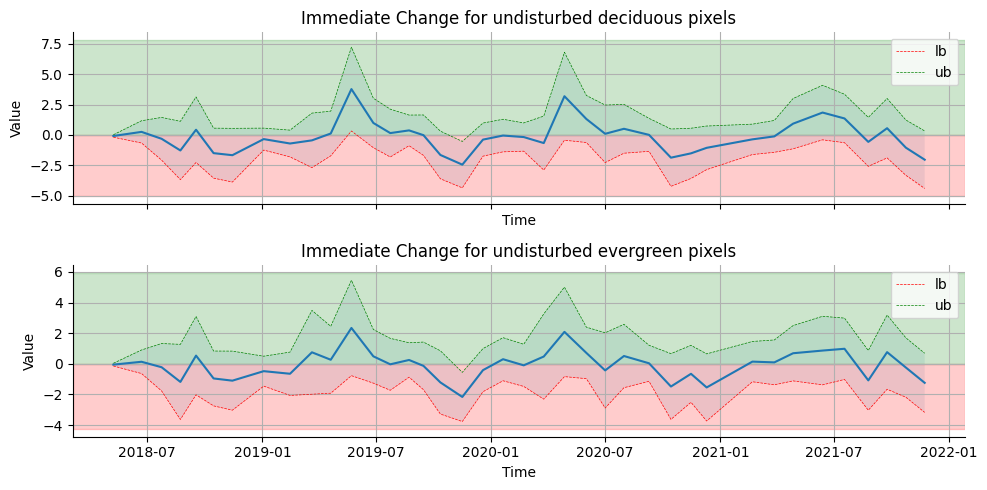

In [17]:
%matplotlib inline
#figure for showing the 'normal' and bounds for gradual changes
fig, ax = plt.subplots(2, 1, figsize=(10, 5), sharex=True)

ax[0].plot(dates, immediate_changes_deciduous_undisturbed.mean(axis=1))
ax[0].set_title('Immediate Change for undisturbed deciduous pixels')
ax[0].fill_between(dates, immediate_changes_deciduous_undisturbed_lb, immediate_changes_deciduous_undisturbed_ub, alpha=0.1)
ax[0].plot(dates, immediate_changes_deciduous_undisturbed_lb, 'r--', label='lb', lw=0.5)
ax[0].plot(dates, immediate_changes_deciduous_undisturbed_ub, 'g--', label='ub', lw=0.5)

ax[1].plot(dates, immediate_changes_evergreen_undisturbed .mean(axis=1))
ax[1].set_title('Immediate Change for undisturbed evergreen pixels')
ax[1].fill_between(dates, immediate_changes_evergreen_undisturbed_lb, immediate_changes_evergreen_undisturbed_ub, alpha=0.1)
ax[1].plot(dates, immediate_changes_evergreen_undisturbed_lb, 'r--', label='lb', lw=0.5)
ax[1].plot(dates, immediate_changes_evergreen_undisturbed_ub, 'g--', label='ub', lw=0.5)

for a in ax:
    a.set_xlabel('Time')
    a.set_ylabel('Value')
    a.grid(True)
    a.legend()
    a.spines['top'].set_visible(False)
    a.spines['right'].set_visible(False)

#add green rectangle on the y = 0,1 zone
ax[0].axhspan(0, ax[0].get_ylim()[1], color='green', alpha=0.2)
ax[0].axhspan(ax[0].get_ylim()[0], 0, color='red', alpha=0.2)
ax[1].axhspan(0, ax[1].get_ylim()[1], color='green', alpha=0.2)
ax[1].axhspan(ax[1].get_ylim()[0], 0, color='red', alpha=0.2)

plt.tight_layout()

In [13]:
#TEST Chaine de markov
import numpy as np
from scipy.signal import convolve2d

# Définir les états
states_description = {
    0: 'non perturbé',
    1: 'perturbation légère',
    2: 'perturbation modérée',
    3: 'perturbation sévère'
}

# Initialisation des états
initial_state = np.zeros_like(tc[0])  # Exemple simplifié

# Matrice de transition des états
# Cette matrice doit être remplie en fonction de votre connaissance du sujet ou des données
# Exemple de matrice de transition simplifiée
norm = np.ones_like(initial_state, dtype=float)
norm[tree_inf == 0 ] = immediate_changes_deciduous_undisturbed.std()*3
norm[tree_inf == 1 ] = immediate_changes_evergreen_undisturbed.std()*3

states = [initial_state]

# Application de la chaîne de Markov
print('Application de la chaîne de Markov')
for i in tqdm(range(1, len(tc))):
    current_state = states[-1]
    next_state = np.zeros_like(current_state)
    
    # Calculez les seuils basé sur les informations précédentes
    undisturbed_slope_lb = np.zeros_like(current_state, dtype=float)
    undisturbed_slope_lb[tree_inf == 0] = immediate_changes_deciduous_undisturbed_lb[i]
    undisturbed_slope_lb[tree_inf == 1] = immediate_changes_evergreen_undisturbed_lb[i]

    # Calcul de la pente et détermination de l'état suivant
    slope = calculate_tree_cover_change(tc[i - 1], tc[i], dates[i - 1], dates[i]) * 365 
    # Détermination de l'état suivant basé sur la différence avec la lower bound
    for state in range(4):
        slope_diff = undisturbed_slope_lb - slope  # Différence entre la lower bound et la pente actuelle
        
        # Définir les transitions en fonction de la différence
        disturbed = slope_diff > 0  # Si la différence est positive, cela signifie que la pente est inférieure à la lower bound
        if disturbed.any():
            # Plus la différence est grande, plus la perturbation est considérée comme sévère
            transition_prob = np.clip(slope_diff * mean_tree_prob_erosion / norm, 0, 1)  # Normalisation de la probabilité
            severity_level = np.digitize(transition_prob, bins=[0.25, 0.5, 0.75])  # Convertit la probabilité en niveaux de sévérité
            
            for level in range(1, 4):  # Les états 1 à 3 représentent les différents niveaux de perturbation
                next_state[(severity_level == level) & disturbed] = level
                
        # État non perturbé
        next_state[~disturbed] = 0 

    states.append(next_state)

# Utiliser convolve2d pour calculer les états en tenant compte des voisins
kernel = np.array([[1, 1, 1],
                   [1, 0, 1],
                   [1, 1, 1]])

print('Application de la convolution')
for i in tqdm(range(1, len(states))):
    neighbor_effect = convolve2d(states[i-1], kernel, mode='same', boundary='wrap') *  mean_tree_prob_erosion
    states[i] = np.where(neighbor_effect > 4, np.minimum(states[i] + 1, 3), states[i])

immediate_changes = states

Application de la chaîne de Markov


100%|██████████| 38/38 [00:04<00:00,  7.80it/s]


Application de la convolution


100%|██████████| 38/38 [00:01<00:00, 23.73it/s]


In [51]:
#write each state to a new folder called 'states'
import os
import rasterio
from tqdm import tqdm

folder_name = 'immediate_change'
os.makedirs(os.path.join(folder_path, folder_name), exist_ok=True)
src = rasterio.open(os.path.join(folder_path, 'rgb', os.listdir(os.path.join(folder_path, 'rgb'))[0]))
dates = [datetime.strptime(filename.split('_')[0], '%Y-%m-%d') for filename in os.listdir(os.path.join(folder_path, 'rgb'))]
dates.sort()
profile = src.profile
profile.update(count=1, dtype='uint8')
for i, state in tqdm(enumerate(states)):
    with rasterio.open(os.path.join(folder_path, folder_name, f'{dates[i].strftime("%Y-%m-%d")}_state.tif'), 'w', **src.profile) as dst:
        dst.write(state.astype('uint8'), 1)

39it [00:01, 25.82it/s]


### Short term changes

In [20]:
#same thing with immediate changes
short_changes_deciduous_undisturbed = short_changes[:, deciduous_undisturbed]
short_changes_evergreen_undisturbed = short_changes[:, evergreen_undisturbed]

#compute the lower and upper bounds
short_changes_deciduous_undisturbed_lb = short_changes_deciduous_undisturbed.mean(axis=1) - 1.5 * k_deciduous * short_changes_deciduous_undisturbed.std(axis=1)
short_changes_evergreen_undisturbed_lb = short_changes_evergreen_undisturbed.mean(axis=1) - 1.5 * k_evergreen * short_changes_evergreen_undisturbed.std(axis=1)
short_changes_deciduous_undisturbed_ub = short_changes_deciduous_undisturbed.mean(axis=1) + 1.5 * k_deciduous * short_changes_deciduous_undisturbed.std(axis=1)
short_changes_evergreen_undisturbed_ub = short_changes_evergreen_undisturbed.mean(axis=1) + 1.5 * k_evergreen * short_changes_evergreen_undisturbed.std(axis=1)

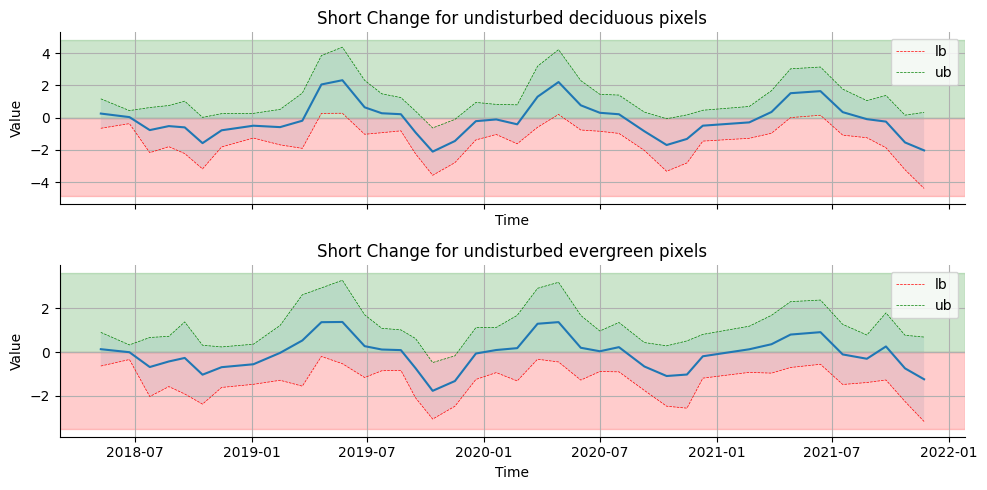

In [21]:
%matplotlib inline
#figure for showing the 'normal' and bounds for gradual changes
fig, ax = plt.subplots(2, 1, figsize=(10, 5), sharex=True)

ax[0].plot(dates, short_changes_deciduous_undisturbed.mean(axis=1))
ax[0].set_title('Short Change for undisturbed deciduous pixels')
ax[0].fill_between(dates, short_changes_deciduous_undisturbed_lb, short_changes_deciduous_undisturbed_ub, alpha=0.1)
ax[0].plot(dates, short_changes_deciduous_undisturbed_lb, 'r--', label='lb', lw=0.5)
ax[0].plot(dates, short_changes_deciduous_undisturbed_ub, 'g--', label='ub', lw=0.5)

ax[1].plot(dates, short_changes_evergreen_undisturbed .mean(axis=1))
ax[1].set_title('Short Change for undisturbed evergreen pixels')
ax[1].fill_between(dates, short_changes_evergreen_undisturbed_lb, short_changes_evergreen_undisturbed_ub, alpha=0.1)
ax[1].plot(dates, short_changes_evergreen_undisturbed_lb, 'r--', label='lb', lw=0.5)
ax[1].plot(dates, short_changes_evergreen_undisturbed_ub, 'g--', label='ub', lw=0.5)

for a in ax:
    a.set_xlabel('Time')
    a.set_ylabel('Value')
    a.grid(True)
    a.legend()
    a.spines['top'].set_visible(False)
    a.spines['right'].set_visible(False)

#add green rectangle on the y = 0,1 zone
ax[0].axhspan(0, ax[0].get_ylim()[1], color='green', alpha=0.2)
ax[0].axhspan(ax[0].get_ylim()[0], 0, color='red', alpha=0.2)
ax[1].axhspan(0, ax[1].get_ylim()[1], color='green', alpha=0.2)
ax[1].axhspan(ax[1].get_ylim()[0], 0, color='red', alpha=0.2)

plt.tight_layout()

In [22]:
#TEST Chaine de markov
import numpy as np
from scipy.signal import convolve2d

# Définir les états
states_description = {
    0: 'non perturbé',
    1: 'perturbation légère',
    2: 'perturbation modérée',
    3: 'perturbation sévère'
}

# Initialisation des états
initial_state = np.zeros_like(tc[0])  # Exemple simplifié

# Matrice de transition des états
# Cette matrice doit être remplie en fonction de votre connaissance du sujet ou des données
# Exemple de matrice de transition simplifiée
norm = np.ones_like(initial_state, dtype=float)
norm[tree_inf == 0 ] = short_changes_deciduous_undisturbed.std()*3
norm[tree_inf == 1 ] = short_changes_evergreen_undisturbed.std()*3

states = [initial_state]
K = 1 

# Application de la chaîne de Markov
print('Application de la chaîne de Markov')
for i in tqdm(range(1, len(tc))):
    current_state = states[-1]
    next_state = np.zeros_like(current_state)
    
    # Calculez les seuils basé sur les informations précédentes
    undisturbed_slope_lb = np.zeros_like(current_state, dtype=float)
    undisturbed_slope_lb[tree_inf == 0] = short_changes_deciduous_undisturbed_lb[i]
    undisturbed_slope_lb[tree_inf == 1] = short_changes_evergreen_undisturbed_lb[i]

    # Calcul de la pente et détermination de l'état suivant
    slope = calculate_slope_with_dates(tc, dates, i, K) * 365
    # Détermination de l'état suivant basé sur la différence avec la lower bound
    for state in range(4):
        slope_diff = undisturbed_slope_lb - slope  # Différence entre la lower bound et la pente actuelle
        
        # Définir les transitions en fonction de la différence
        disturbed = slope_diff > 0  # Si la différence est positive, cela signifie que la pente est inférieure à la lower bound
        if disturbed.any():
            # Plus la différence est grande, plus la perturbation est considérée comme sévère
            transition_prob = np.clip(slope_diff * mean_tree_prob_erosion / norm, 0, 1)  # Normalisation de la probabilité
            severity_level = np.digitize(transition_prob, bins=[0.25, 0.5, 0.75])  # Convertit la probabilité en niveaux de sévérité
            
            for level in range(1, 4):  # Les états 1 à 3 représentent les différents niveaux de perturbation
                next_state[(severity_level == level) & disturbed] = level
                
        # État non perturbé
        next_state[~disturbed] = 0 

    states.append(next_state)

# Utiliser convolve2d pour calculer les états en tenant compte des voisins
kernel = np.array([[1, 1, 1],
                   [1, 0, 1],
                   [1, 1, 1]])

print('Application de la convolution')
for i in tqdm(range(1, len(states))):
    neighbor_effect = convolve2d(states[i-1], kernel, mode='same', boundary='wrap') *  mean_tree_prob_erosion
    states[i] = np.where(neighbor_effect > 4, np.minimum(states[i] + 1, 3), states[i])



Application de la chaîne de Markov


100%|██████████| 38/38 [00:04<00:00,  7.89it/s]


Application de la convolution


100%|██████████| 38/38 [00:01<00:00, 26.04it/s]


In [23]:
#write each state to a new folder called 'states'
import os
import rasterio
from tqdm import tqdm

folder_name = 'short_change'
os.makedirs(os.path.join(folder_path, folder_name), exist_ok=True)
src = rasterio.open(os.path.join(folder_path, 'rgb', os.listdir(os.path.join(folder_path, 'rgb'))[0]))
dates = [datetime.strptime(filename.split('_')[0], '%Y-%m-%d') for filename in os.listdir(os.path.join(folder_path, 'rgb'))]
dates.sort()
profile = src.profile
profile.update(count=1, dtype='uint8')
for i, state in tqdm(enumerate(states)):
    with rasterio.open(os.path.join(folder_path, folder_name, f'{dates[i].strftime("%Y-%m-%d")}_state.tif'), 'w', **src.profile) as dst:
        dst.write(state.astype('uint8'), 1)

39it [00:01, 27.30it/s]


## Rules

In [16]:
def map_to_state_vectorized(immediate, gradual, recovery):
    # Start by assuming all pixels are 'Undisturbed'
    states = np.zeros(immediate.shape, dtype=int)
    
    # Conditions for 'Dieback'
    dieback_mask = (gradual >= 1) & (immediate < 2)
    states[dieback_mask] = 1
    
    # Conditions for 'Disturbed'
    disturbed_mask = (immediate >= 2) & (gradual < 2)
    states[disturbed_mask] = 2
    
    # Conditions for 'Recovery'
    recovery_mask = (recovery >= 2) & (immediate < 1)
    states[recovery_mask] = 3
    
    return states

def calculate_tpm_vectorized(state_array):
    num_states = 4
    transition_counts = np.zeros((num_states, num_states))

    # Flatten the states array for time steps t and t+1
    current_states = state_array[:-1].flatten()
    next_states = state_array[1:].flatten()

    # Compute transitions using a vectorized approach
    for i in tqdm(range(num_states)):
        for j in range(num_states):
            transition_counts[i, j] = np.sum((current_states == i) & (next_states == j))

    # Calculate probabilities
    row_sums = transition_counts.sum(axis=1, keepdims=True)
    transition_probabilities = np.divide(transition_counts, row_sums, where=row_sums != 0)

    return transition_probabilities

immediate_changes = np.array(immediate_changes)
gradual_changes = np.array(gradual_changes)
recovery = np.array(recovery)
state_array = map_to_state_vectorized(immediate_changes, gradual_changes, recovery)
tpm = calculate_tpm_vectorized(state_array)


100%|██████████| 4/4 [00:02<00:00,  1.99it/s]


In [49]:
#write each state to a new folder called 'states'
import os
import rasterio
from tqdm import tqdm

folder_name = 'states'
os.makedirs(os.path.join(folder_path, folder_name), exist_ok=True)
src = rasterio.open(os.path.join(folder_path, 'rgb', os.listdir(os.path.join(folder_path, 'rgb'))[0]))
dates = [datetime.strptime(filename.split('_')[0], '%Y-%m-%d') for filename in os.listdir(os.path.join(folder_path, 'rgb'))]
dates.sort()
profile = src.profile
profile.update(count=1, dtype='uint8')
for i, state in tqdm(enumerate(state_array)):
    with rasterio.open(os.path.join(folder_path, folder_name, f'{dates[i].strftime("%Y-%m-%d")}_state.tif'), 'w', **src.profile) as dst:
        dst.write(state.astype('uint8'), 1)

0it [00:00, ?it/s]

39it [00:01, 28.31it/s]


In [17]:
%matplotlib notebook

import os
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

rgb = load_folder(os.path.join(folder_path, 'rgb'))

# Define a custom colormap for the four states
colors = ['white', 'yellow', 'red', 'green']  # Colors for 'Undisturbed', 'Dieback', 'Disturbed', 'Recovery'
cmap = ListedColormap(colors)

def animate_states(states, rgb):
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))

    # Initialize the plots
    state_img = ax[0].imshow(states[0], cmap=cmap, vmin=0, vmax=3, interpolation='none')
    rgb_img = ax[1].imshow(normalize(rgb[0]).transpose(1, 2, 0))

    ax[0].set_axis_off()
    ax[1].set_axis_off()
    ax[0].set_title('State Grid')
    ax[1].set_title('RGB Image')

    def update(frame):
        """Update function for animation."""
        state_img.set_data(states[frame])
        rgb_img.set_data(normalize(rgb[frame]).transpose(1, 2, 0))  # Assuming rgb is properly scaled

        ax[0].set_title(f'Time Step: {frame}')
        return state_img, rgb_img,

    # Create animation
    ani = FuncAnimation(fig, update, frames=len(states), interval=100, blit=True)

    # Close the figure to prevent it from displaying statically (uncomment if necessary in your environment)
    # plt.close(fig)
    return HTML(ani.to_jshtml()) 

# Example usage:
# Assuming 'states' and 'rgb' are lists of numpy arrays
# This function would be called in your notebook like so:
animation = animate_states(states, rgb)
display(animation)


100%|██████████| 39/39 [00:01<00:00, 38.43it/s]


<IPython.core.display.Javascript object>

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i